# <p style="background-color:DarkSlateBlue;font-family:newtimeroman;font-size:175%;color:white;text-align:center;border-radius:20px 20px;"><b> Raisin Class Prediction

Data Set Information:

Images of Kecimen and Besni raisin varieties grown in Turkey were obtained with CVS. A total of 900 raisin grains were used, including 450 pieces from both varieties. These images were subjected to various stages of pre-processing and 7 morphological features were extracted. These features have been classified using three different artificial intelligence techniques.


Attribute Information:

1. **Area:** Gives the number of pixels within the boundaries of the raisin.
2. **Perimeter:** It measures the environment by calculating the distance between the boundaries of the raisin and the pixels around it.
3. **MajorAxisLength:** Gives the length of the main axis, which is the longest line that can be drawn on the raisin.
4. **MinorAxisLength:** Gives the length of the small axis, which is the shortest line that can be drawn on the raisin.
5. **Eccentricity:** It gives a measure of the eccentricity of the ellipse, which has the same moments as raisins.
6. **ConvexArea:** Gives the number of pixels of the smallest convex shell of the region formed by the raisin.
7. **Extent:** Gives the ratio of the region formed by the raisin to the total pixels in the bounding box.
8. **Class:** Kecimen and Besni raisin.

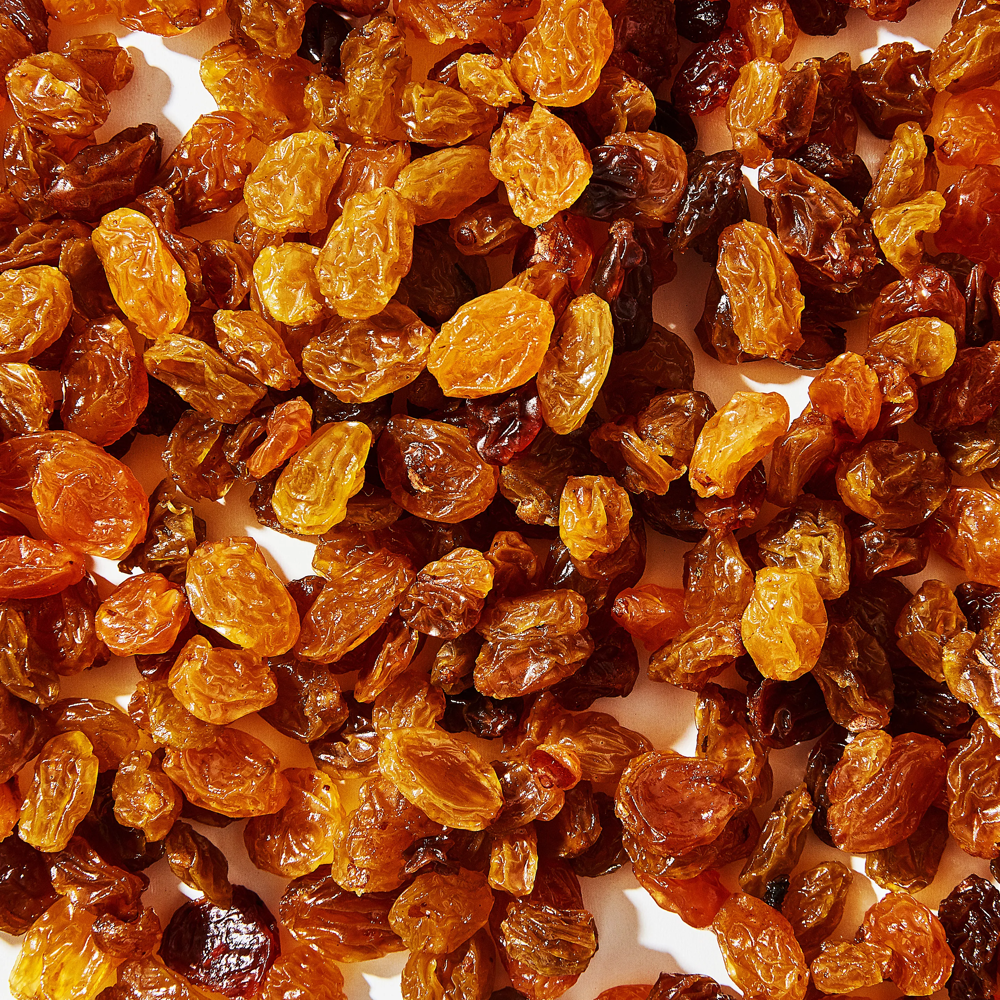

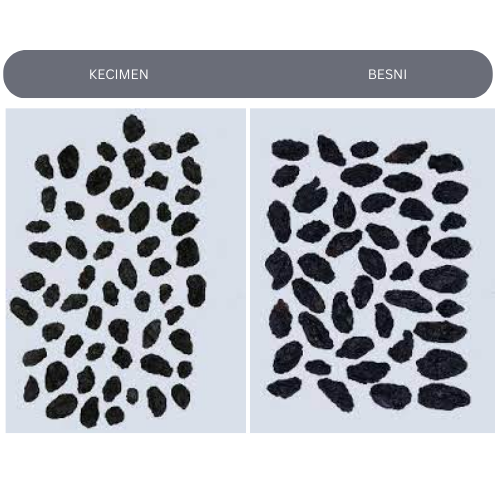

# <font color='Orchid'> <b>Import Libraries</b><font color='black'>

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

%matplotlib inline
#%matplotlib notebook
plt.rcParams["figure.figsize"] = (10,6)
import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")
pd.set_option('display.float_format', lambda x: '%.3f' % x)

# <font color='Orchid'> <b>Exploratory Data Analysis, Visualization and Feature Engineering</b><font color='black'>

In [2]:
df0 = pd.read_excel("Raisin_Dataset.xlsx")
df = df0.copy()
df

# target -> Class

,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,Extent,Perimeter,Class
0,87524,442.246,253.291,0.820,90546,0.759,1184.040,Kecimen
1,75166,406.691,243.032,0.802,78789,0.684,1121.786,Kecimen
2,90856,442.267,266.328,0.798,93717,0.638,1208.575,Kecimen
3,45928,286.541,208.760,0.685,47336,0.700,844.162,Kecimen
4,79408,352.191,290.828,0.564,81463,0.793,1073.251,Kecimen
...,...,...,...,...,...,...,...,...
895,83248,430.077,247.839,0.817,85839,0.669,1129.072,Besni
896,87350,440.736,259.293,0.809,90899,0.636,1214.252,Besni
897,99657,431.707,298.837,0.722,106264,0.741,1292.828,Besni
898,93523,476.344,254.176,0.846,97653,0.659,1258.548,Besni


In [3]:
df.shape

(900, 8)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 900 entries, 0 to 899
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Area             900 non-null    int64  
 1   MajorAxisLength  900 non-null    float64
 2   MinorAxisLength  900 non-null    float64
 3   Eccentricity     900 non-null    float64
 4   ConvexArea       900 non-null    int64  
 5   Extent           900 non-null    float64
 6   Perimeter        900 non-null    float64
 7   Class            900 non-null    object 
dtypes: float64(5), int64(2), object(1)
memory usage: 56.4+ KB


In [5]:
df.duplicated().sum()

0

In [6]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Area,900.000,87804.128,39002.111,25387.000,59348.000,78902.000,105028.250,235047.000
MajorAxisLength,900.000,430.930,116.035,225.630,345.443,407.804,494.187,997.292
MinorAxisLength,900.000,254.488,49.989,143.711,219.111,247.848,279.889,492.275
Eccentricity,900.000,0.782,0.090,0.349,0.742,0.799,0.843,0.962
ConvexArea,900.000,91186.090,40769.290,26139.000,61513.250,81651.000,108375.750,278217.000
Extent,900.000,0.700,0.053,0.380,0.671,0.707,0.735,0.835
Perimeter,900.000,1165.907,273.764,619.074,966.411,1119.509,1308.390,2697.753


In [7]:
df.describe(include="object").T

,count,unique,top,freq
Class,900,2,Kecimen,450


In [8]:
df['Class'].value_counts() # balanced

Class
Kecimen    450
Besni      450
Name: count, dtype: int64

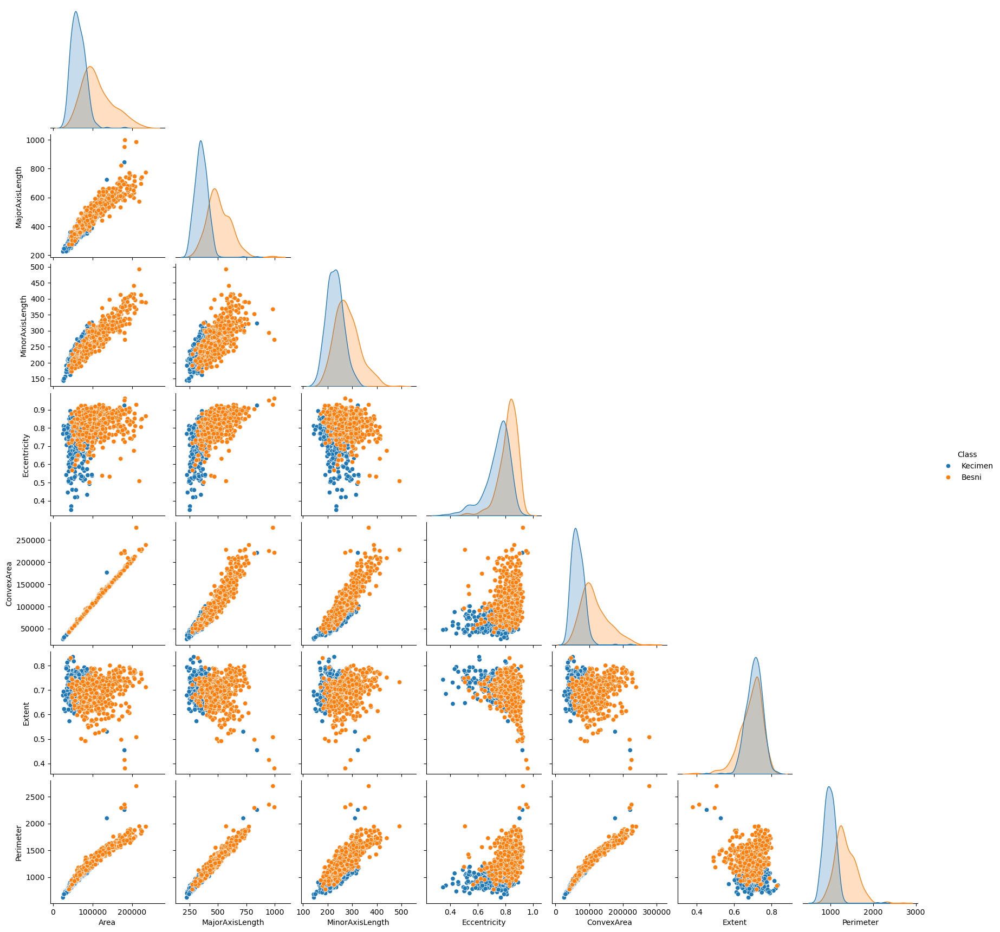

In [9]:
sns.pairplot(data=df, corner=True, hue='Class');

### <font color='RebeccaPurple'> <b>Mapping Target Values</b><font color='black'>

In [10]:
df["class_number"] = df['Class'].map({'Kecimen': 1, 'Besni': 0})

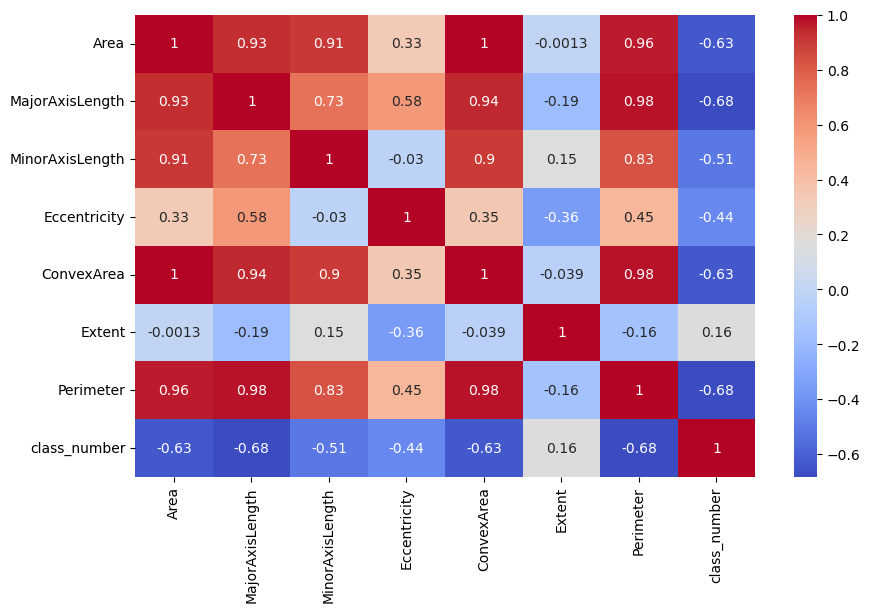

In [22]:
sns.heatmap(df.select_dtypes('number').corr(), cmap= 'coolwarm', annot=True);

In [12]:
df.columns

Index(['Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity',
       'ConvexArea', 'Extent', 'Perimeter', 'Class', 'class_number'],
      dtype='object')

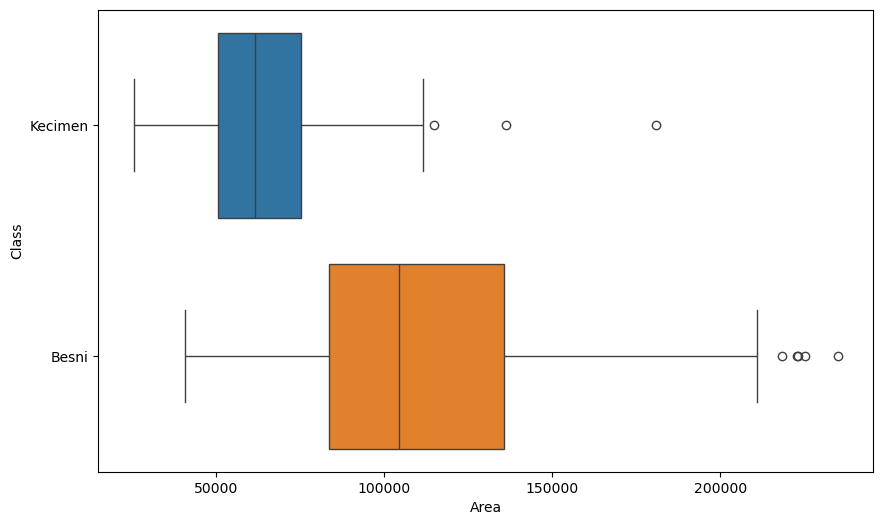

In [13]:
sns.boxplot(x="Area", y="Class", data=df, palette='tab10');

In [14]:
kecimen_subset = df[df['Class'] == 'Kecimen']

max_area_row = kecimen_subset[kecimen_subset['Area'] == kecimen_subset['Area'].max()]

df.drop(max_area_row.index, inplace= True)

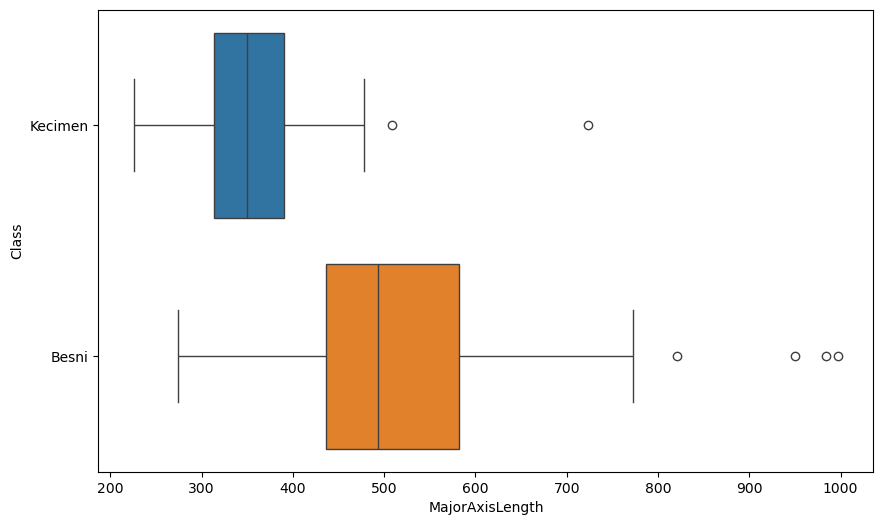

In [15]:
sns.boxplot(x="MajorAxisLength", y="Class", data=df, palette='tab10');

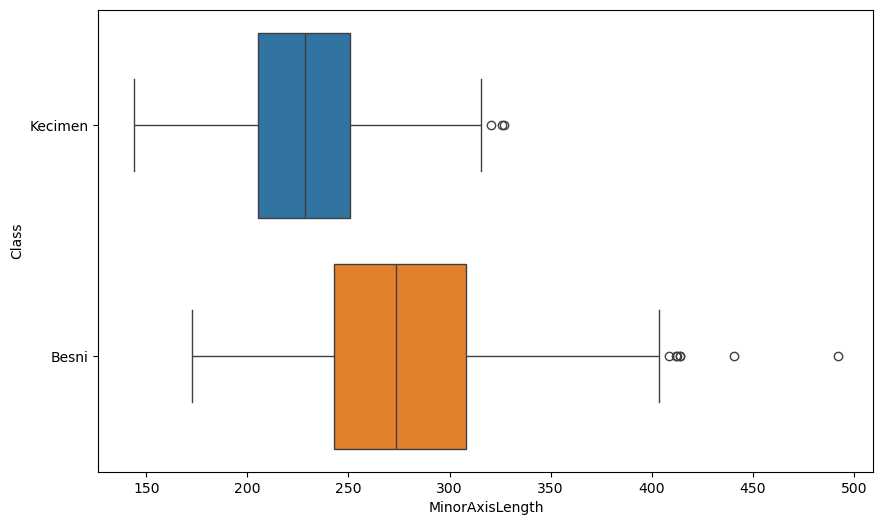

In [16]:
sns.boxplot(x="MinorAxisLength", y="Class", data=df, palette='tab10');

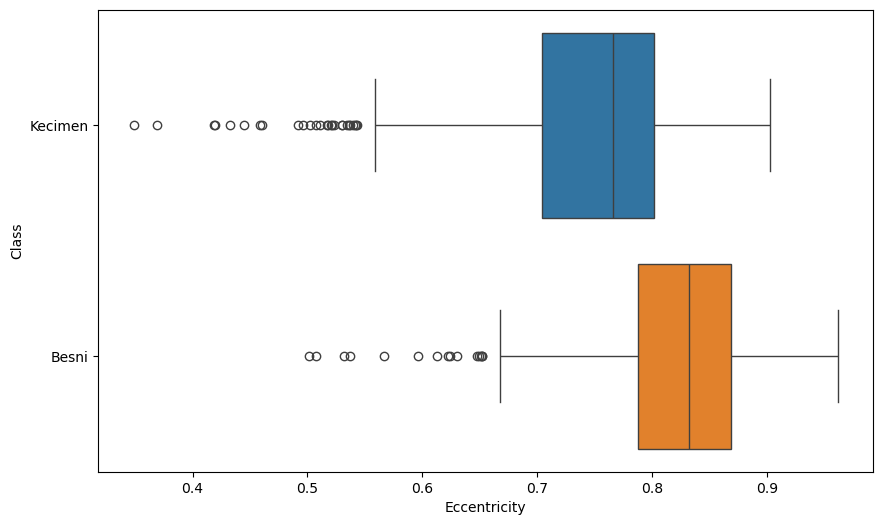

In [17]:
sns.boxplot(x="Eccentricity", y="Class", data=df, palette='tab10');

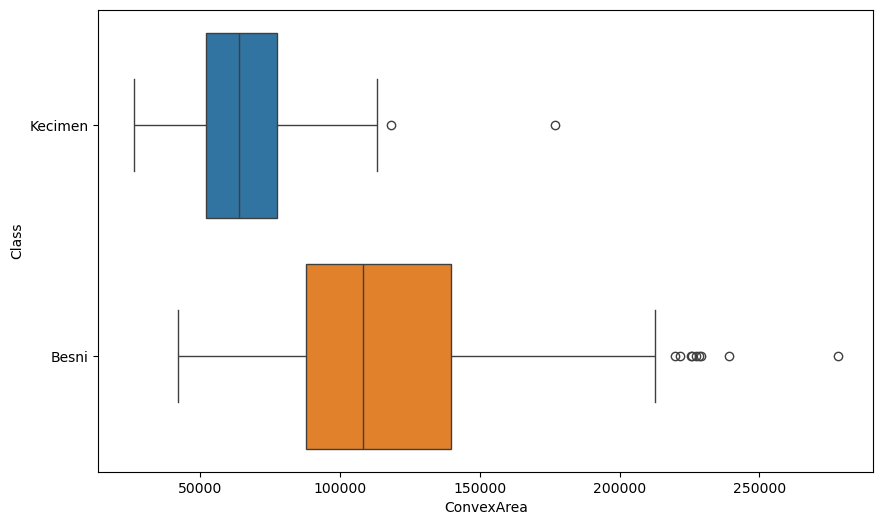

In [18]:
sns.boxplot(x="ConvexArea", y="Class", data=df, palette='tab10');

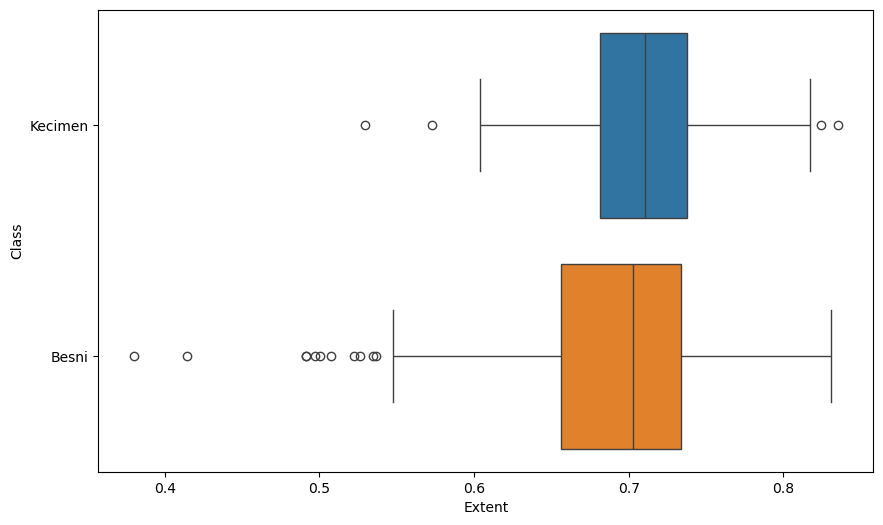

In [19]:
sns.boxplot(x="Extent", y="Class", data=df, palette='tab10');

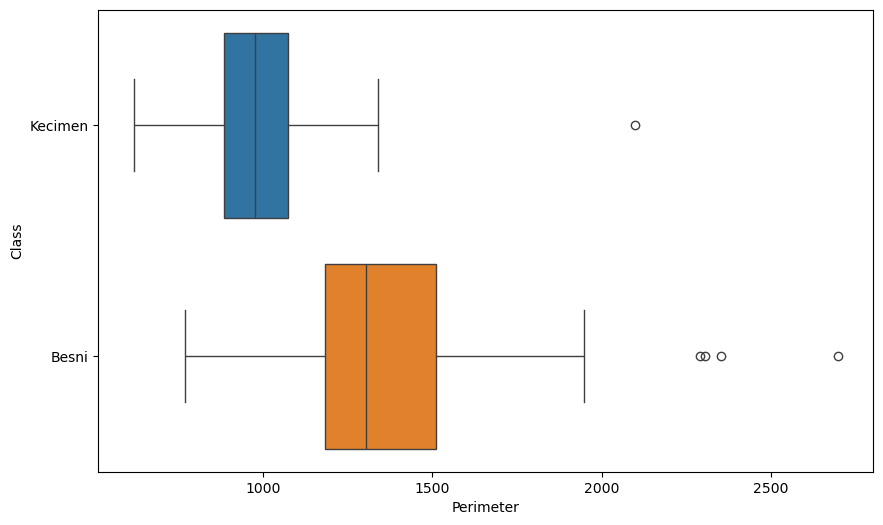

In [20]:
sns.boxplot(x="Perimeter", y="Class", data=df, palette='tab10');

# <font color='Orchid'> <b>Multicollinearity check</b><font color='black'>

In [21]:
def color_correlation2(val):
    """
    Takes a scalar and returns a string with
    the css property in a variety of color scales 
    for different correlations.
    """
    if val >= 0.9 and val < 0.99999 or val <= -0.8 and val > -0.99999:
        color = 'red'
    elif val < 0.9 and val >= 0.3 or val > -0.8 and val <= -0.3:
        color = 'blue'
    elif val == 1:
        color = 'green'    
    else:
        color = 'black'
    return 'color: %s' % color

df.select_dtypes('number').corr().style.applymap(color_correlation2)

# Featurların kendi arasındaki corr. -0.90, +0.90 'dan büyük olan değerleri istediğimiz renkte göstermesi kullanıyoruz.

,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,Extent,Perimeter,class_number
Area,1.000000,0.932861,0.906829,0.333440,0.996252,-0.001324,0.962317,-0.630726
MajorAxisLength,0.932861,1.000000,0.728501,0.582288,0.944398,-0.189234,0.977722,-0.682363
MinorAxisLength,0.906829,0.728501,1.000000,-0.030167,0.896810,0.154323,0.829524,-0.505444
Eccentricity,0.333440,0.582288,-0.030167,1.000000,0.345049,-0.357722,0.445420,-0.441107
ConvexArea,0.996252,0.944398,0.896810,0.345049,1.000000,-0.039167,0.976617,-0.633077
Extent,-0.001324,-0.189234,0.154323,-0.357722,-0.039167,1.000000,-0.156358,0.161791
Perimeter,0.962317,0.977722,0.829524,0.445420,0.976617,-0.156358,1.000000,-0.676750
class_number,-0.630726,-0.682363,-0.505444,-0.441107,-0.633077,0.161791,-0.676750,1.000000


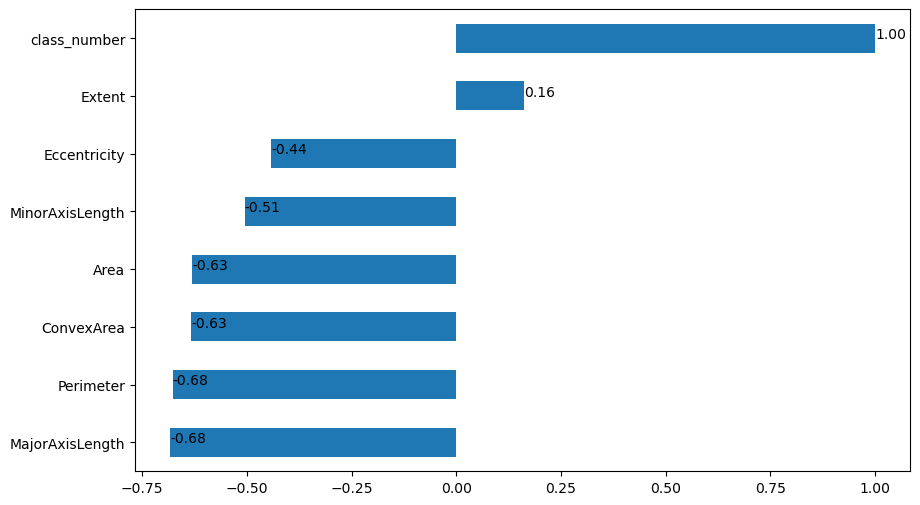

In [22]:
corr_values = df.select_dtypes('number').corr()["class_number"].sort_values()
ax = corr_values.plot.barh()
for index, value in enumerate(corr_values):
    plt.text(value, index, "{:.2f}".format(value))

plt.show()

- perimeter and majoraxislength has the same correlation with target and it has multicollinearity with each other, so we can drop one of the features

- same thing with are and convex area

- dropping Area and perimeter (these have more correlation with other features)

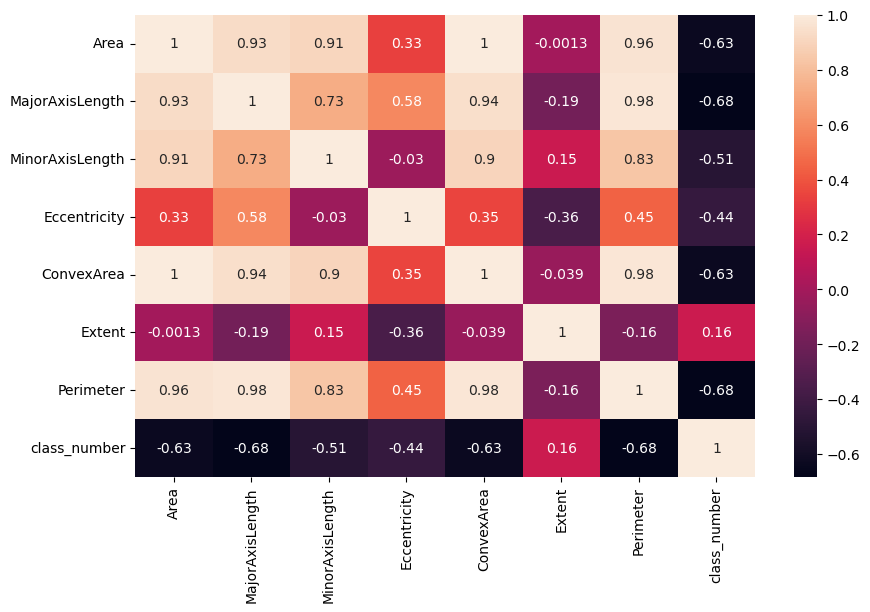

In [23]:
sns.heatmap(df.select_dtypes('number').corr(), annot=True);

In [24]:
# df.drop(columns= ['Extent'], axis=1, inplace=True)

In [25]:
def color_correlation2(val):
    """
    Takes a scalar and returns a string with
    the css property in a variety of color scales 
    for different correlations.
    """
    if val >= 0.9 and val < 0.99999 or val <= -0.8 and val > -0.99999:
        color = 'red'
    elif val < 0.9 and val >= 0.3 or val > -0.8 and val <= -0.3:
        color = 'blue'
    elif val == 1:
        color = 'green'    
    else:
        color = 'black'
    return 'color: %s' % color

df.select_dtypes('number').corr().style.applymap(color_correlation2)

# class_number  -> target

,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,Extent,Perimeter,class_number
Area,1.000000,0.932861,0.906829,0.333440,0.996252,-0.001324,0.962317,-0.630726
MajorAxisLength,0.932861,1.000000,0.728501,0.582288,0.944398,-0.189234,0.977722,-0.682363
MinorAxisLength,0.906829,0.728501,1.000000,-0.030167,0.896810,0.154323,0.829524,-0.505444
Eccentricity,0.333440,0.582288,-0.030167,1.000000,0.345049,-0.357722,0.445420,-0.441107
ConvexArea,0.996252,0.944398,0.896810,0.345049,1.000000,-0.039167,0.976617,-0.633077
Extent,-0.001324,-0.189234,0.154323,-0.357722,-0.039167,1.000000,-0.156358,0.161791
Perimeter,0.962317,0.977722,0.829524,0.445420,0.976617,-0.156358,1.000000,-0.676750
class_number,-0.630726,-0.682363,-0.505444,-0.441107,-0.633077,0.161791,-0.676750,1.000000


In [26]:
df.drop(columns= ['Class'], axis=1, inplace=True)
df

,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,Extent,Perimeter,class_number
0,87524,442.246,253.291,0.820,90546,0.759,1184.040,1
1,75166,406.691,243.032,0.802,78789,0.684,1121.786,1
2,90856,442.267,266.328,0.798,93717,0.638,1208.575,1
3,45928,286.541,208.760,0.685,47336,0.700,844.162,1
4,79408,352.191,290.828,0.564,81463,0.793,1073.251,1
...,...,...,...,...,...,...,...,...
895,83248,430.077,247.839,0.817,85839,0.669,1129.072,0
896,87350,440.736,259.293,0.809,90899,0.636,1214.252,0
897,99657,431.707,298.837,0.722,106264,0.741,1292.828,0
898,93523,476.344,254.176,0.846,97653,0.659,1258.548,0


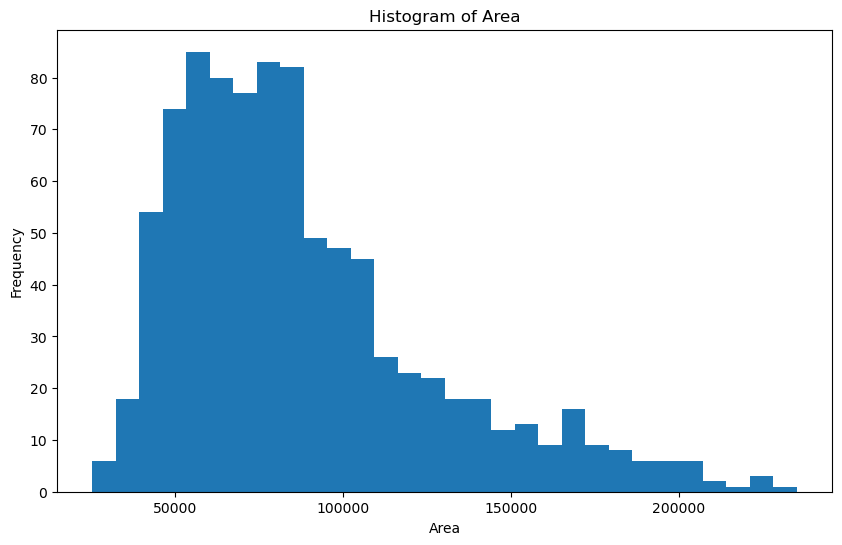

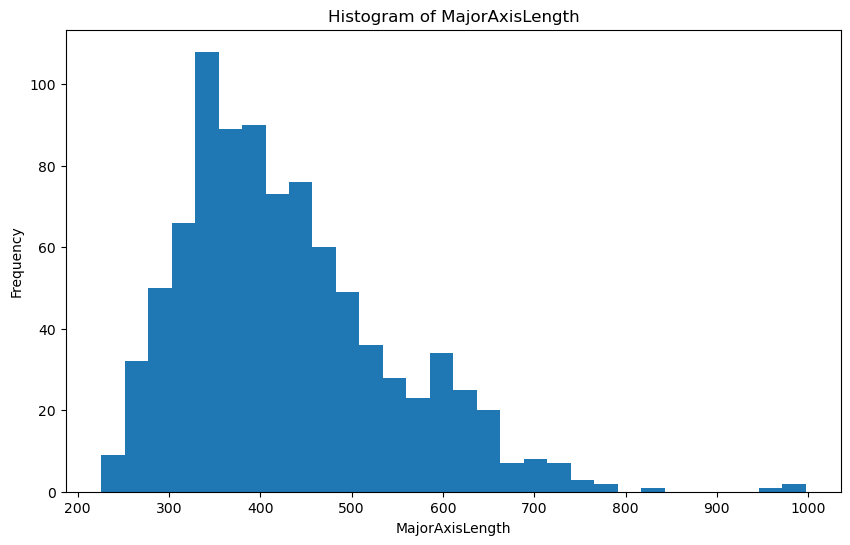

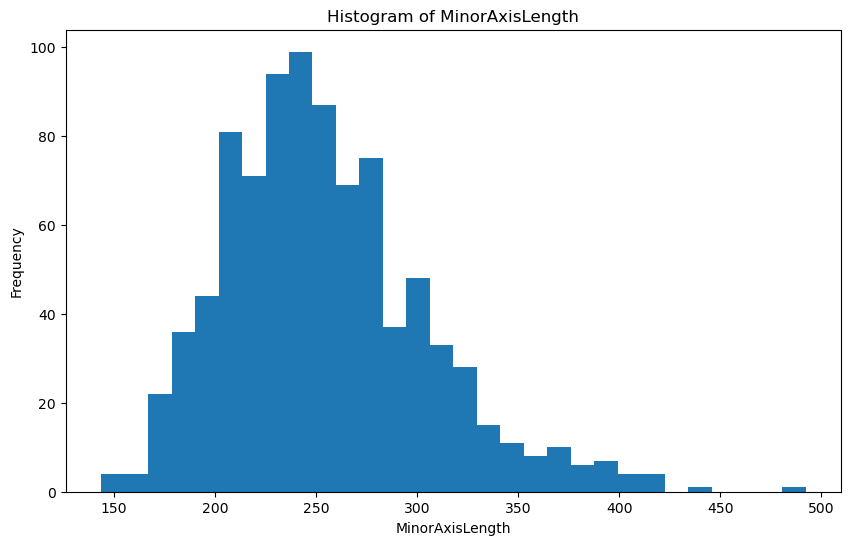

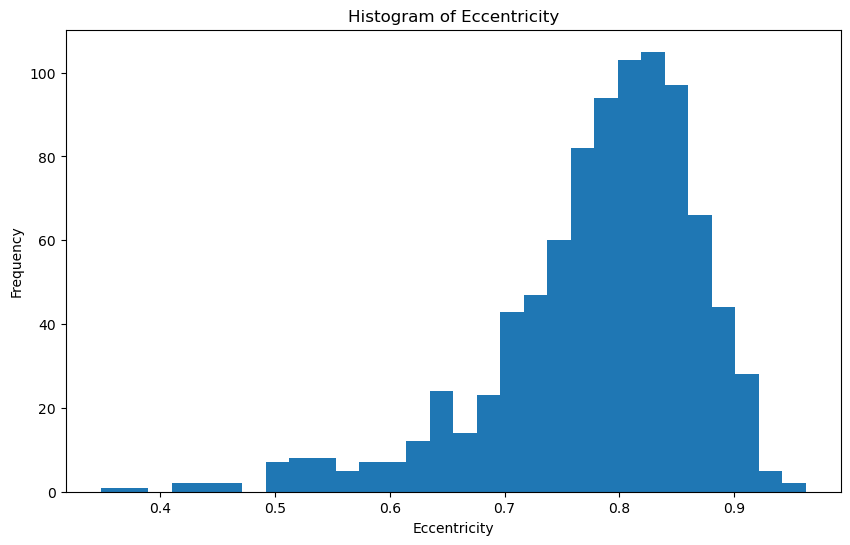

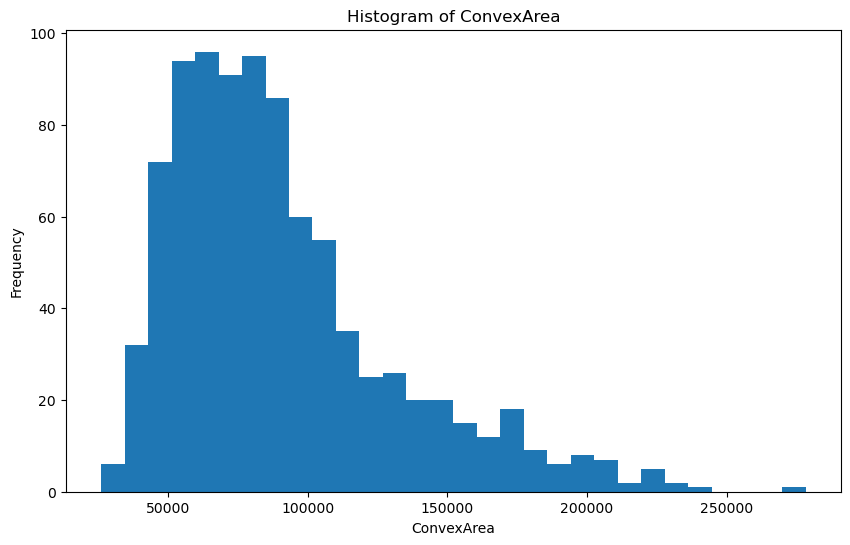

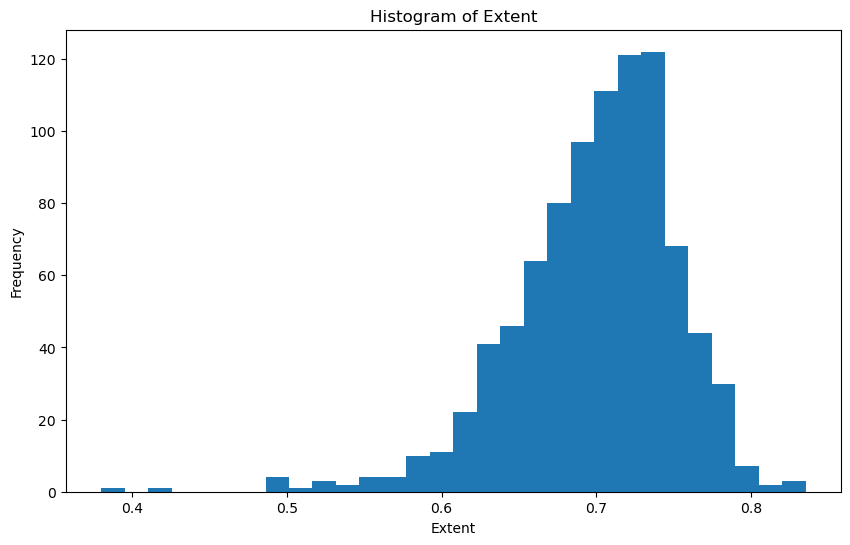

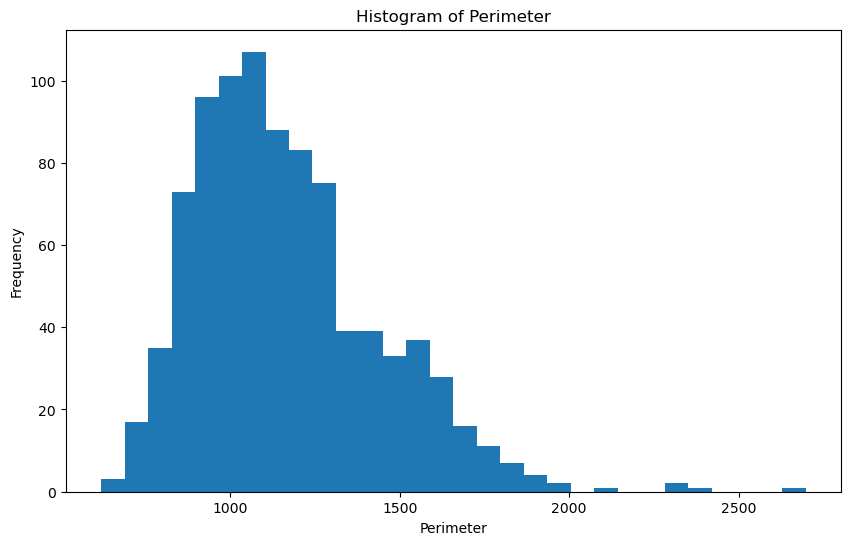

In [ ]:
for column in df.columns:
    if column == 'class_number':
        continue
    else:
        plt.figure()
        plt.hist(df[column], bins=30)
        plt.title(f'Histogram of {column}')
        plt.xlabel(column)
        plt.ylabel('Frequency')
        plt.show()

# <font color='Orchid'> <b>Train | Test Split and Scaling</b><font color='black'>

In [28]:
X = df.drop('class_number', axis= 1)
y = df['class_number']

In [29]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

In [30]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=10)

In [31]:
scaler = StandardScaler()

In [32]:
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# <font color='Orchid'> <b>Logistic Regression</b><font color='black'>

In [33]:
from sklearn.linear_model import LogisticRegression

log_model = LogisticRegression()

log_model.fit(X_train_scaled, y_train)

LogisticRegression()

In [34]:
log_model.coef_ 

array([[-0.31604452, -0.82199653,  0.96363955,  0.01302178, -0.74235849,
         0.30434497, -2.5348646 ]])

In [35]:
log_model.intercept_

array([-0.62210596])

In [36]:
y_pred = log_model.predict(X_test_scaled)
y_pred

array([1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1,
       1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0,
       0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1,
       1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0,
       0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0,
       1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1,
       0, 1, 0, 1], dtype=int64)

In [37]:
y_pred_proba = log_model.predict_proba(X_test_scaled)
y_pred_proba

array([[8.61619248e-02, 9.13838075e-01],
       [3.77026332e-01, 6.22973668e-01],
       [9.79981162e-01, 2.00188384e-02],
       [9.97350971e-01, 2.64902931e-03],
       [4.64463699e-01, 5.35536301e-01],
       [7.43790081e-01, 2.56209919e-01],
       [2.12052601e-01, 7.87947399e-01],
       [9.89501053e-01, 1.04989473e-02],
       [9.88862566e-01, 1.11374336e-02],
       [2.07059268e-01, 7.92940732e-01],
       [3.38023851e-01, 6.61976149e-01],
       [9.99293484e-01, 7.06516296e-04],
       [5.18069289e-02, 9.48193071e-01],
       [2.81260434e-01, 7.18739566e-01],
       [8.72504557e-01, 1.27495443e-01],
       [2.54736539e-01, 7.45263461e-01],
       [3.17543294e-01, 6.82456706e-01],
       [8.83401060e-01, 1.16598940e-01],
       [1.24476046e-01, 8.75523954e-01],
       [1.45073729e-02, 9.85492627e-01],
       [8.33467220e-01, 1.66532780e-01],
       [4.68617949e-01, 5.31382051e-01],
       [1.81091271e-01, 8.18908729e-01],
       [5.34426787e-01, 4.65573213e-01],
       [9.998668

In [38]:
y_pred_proba = log_model.predict_proba(X_test_scaled)
y_pred_proba_rounded = np.round(y_pred_proba, 2)  # e'li değerleri normal değerlere convert ettik
y_pred_proba_rounded

array([[0.09, 0.91],
       [0.38, 0.62],
       [0.98, 0.02],
       [1.  , 0.  ],
       [0.46, 0.54],
       [0.74, 0.26],
       [0.21, 0.79],
       [0.99, 0.01],
       [0.99, 0.01],
       [0.21, 0.79],
       [0.34, 0.66],
       [1.  , 0.  ],
       [0.05, 0.95],
       [0.28, 0.72],
       [0.87, 0.13],
       [0.25, 0.75],
       [0.32, 0.68],
       [0.88, 0.12],
       [0.12, 0.88],
       [0.01, 0.99],
       [0.83, 0.17],
       [0.47, 0.53],
       [0.18, 0.82],
       [0.53, 0.47],
       [1.  , 0.  ],
       [0.07, 0.93],
       [0.02, 0.98],
       [0.12, 0.88],
       [0.93, 0.07],
       [0.15, 0.85],
       [0.53, 0.47],
       [0.38, 0.62],
       [0.92, 0.08],
       [0.11, 0.89],
       [0.06, 0.94],
       [1.  , 0.  ],
       [0.98, 0.02],
       [1.  , 0.  ],
       [0.56, 0.44],
       [0.06, 0.94],
       [0.15, 0.85],
       [0.48, 0.52],
       [0.06, 0.94],
       [0.97, 0.03],
       [1.  , 0.  ],
       [0.91, 0.09],
       [1.  , 0.  ],
       [0.76,

In [39]:
test_data = pd.concat([X_test, y_test], axis = 1)
test_data["pred_proba"] = y_pred_proba[:, 1]
test_data["pred"] = y_pred
test_data

,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,Extent,Perimeter,class_number,pred_proba,pred
825,61556,340.784,231.435,0.734,63181,0.735,956.302,0,0.914,1
436,79055,395.369,258.276,0.757,82562,0.720,1114.488,1,0.623,1
810,123654,542.420,293.473,0.841,126325,0.660,1400.524,0,0.020,0
527,163442,594.759,351.426,0.807,167471,0.705,1621.959,0,0.003,0
283,78352,408.810,245.441,0.800,80474,0.684,1099.512,1,0.536,1
...,...,...,...,...,...,...,...,...,...,...
229,76741,383.982,258.134,0.740,79198,0.745,1056.740,1,0.790,1
512,101661,440.982,295.531,0.742,105429,0.713,1268.050,0,0.248,0
112,51448,328.290,202.160,0.788,52772,0.705,877.799,1,0.937,1
461,64391,449.556,187.122,0.909,68813,0.634,1177.714,0,0.127,0


In [40]:
#tüm hataları listeledik

wrong_predict = test_data[((test_data["class_number"]==1) & (test_data["pred"]==0)) | ((test_data["class_number"]==0) & (test_data["pred"]==1))]
wrong_predict

,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,Extent,Perimeter,class_number,pred_proba,pred
825,61556,340.784,231.435,0.734,63181,0.735,956.302,0,0.914,1
585,61444,371.694,213.180,0.819,64321,0.737,1006.984,0,0.793,1
54,111450,478.311,298.631,0.781,113256,0.690,1298.188,1,0.127,0
706,60674,345.315,225.219,0.758,62614,0.736,987.617,0,0.876,1
839,68510,348.401,252.993,0.688,70513,0.671,1028.839,0,0.819,1
92,85156,422.279,260.211,0.788,87057,0.703,1140.684,1,0.474,0
838,92619,398.621,296.883,0.667,95666,0.743,1173.390,0,0.617,1
341,89051,418.556,274.923,0.754,92636,0.739,1196.030,1,0.444,0
851,73699,408.586,231.142,0.825,76106,0.703,1079.578,0,0.568,1
337,83490,421.883,254.310,0.798,86319,0.710,1168.247,1,0.402,0


In [41]:
wrong_predict.shape

(29, 10)

## <font color='RebeccaPurple'> <b>Model Performance</b><font color='black'>

In [42]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, log_loss

### accuracy

In [43]:
accuracy_score(y_test, y_pred)

0.8388888888888889

In [44]:
log_model.score(X_test_scaled, y_test)

# log_model score = accuracy_score

0.8388888888888889

### precision

In [45]:
precision_score(y_test, y_pred)

0.8426966292134831

### recall

In [46]:
recall_score(y_test, y_pred)

0.8333333333333334

### f1

In [47]:
f1_score(y_test, y_pred)

0.8379888268156424

### log loss

In [48]:
log_loss(y_test, y_pred) # model performansi kotu

5.80703304602443

## <font color='RebeccaPurple'> <b>Confusion Matrix</b><font color='black'>

In [49]:
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay

In [50]:
confusion_matrix(y_test, y_pred)

array([[76, 14],
       [15, 75]], dtype=int64)

- True Negative (TN): top left <br>
- False Positive (FP): top right <br>
- False Negative (FN): bottom left <br>
- True Positive (TP): bottom right <br>

In [51]:
# EXAMPLE

TP = 10
TN = 70
FP = 0
FN = 10

acc = (TP + TN) / (TP + TN + FP + FN)
prec = TP / (TP + FP)
recc = TP / (TP + FN)
F1 = 2 * ((prec * recc) / (prec + recc))

print("Accuracy : {:.2f}".format(acc))
print("Precision: {:.2f}".format(prec))
print("Recall   : {:.2f}".format(recc))
print("F1 Score : {:.2f}".format(F1))

Accuracy : 0.89
Precision: 1.00
Recall   : 0.50
F1 Score : 0.67


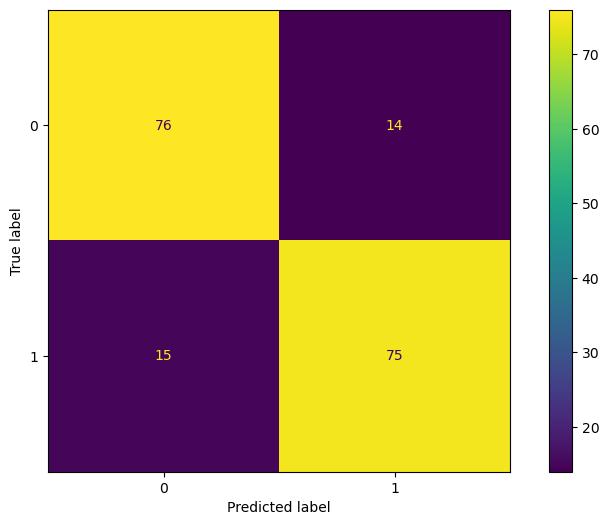

In [52]:
ConfusionMatrixDisplay.from_estimator(log_model, X_test_scaled, y_test);

## <font color='RebeccaPurple'> <b>Cross Validate</b><font color='black'>

In [53]:
from sklearn.model_selection import cross_validate

In [54]:
from sklearn.metrics import get_scorer_names
get_scorer_names()

['accuracy',
 'adjusted_mutual_info_score',
 'adjusted_rand_score',
 'average_precision',
 'balanced_accuracy',
 'completeness_score',
 'explained_variance',
 'f1',
 'f1_macro',
 'f1_micro',
 'f1_samples',
 'f1_weighted',
 'fowlkes_mallows_score',
 'homogeneity_score',
 'jaccard',
 'jaccard_macro',
 'jaccard_micro',
 'jaccard_samples',
 'jaccard_weighted',
 'matthews_corrcoef',
 'max_error',
 'mutual_info_score',
 'neg_brier_score',
 'neg_log_loss',
 'neg_mean_absolute_error',
 'neg_mean_absolute_percentage_error',
 'neg_mean_gamma_deviance',
 'neg_mean_poisson_deviance',
 'neg_mean_squared_error',
 'neg_mean_squared_log_error',
 'neg_median_absolute_error',
 'neg_negative_likelihood_ratio',
 'neg_root_mean_squared_error',
 'normalized_mutual_info_score',
 'positive_likelihood_ratio',
 'precision',
 'precision_macro',
 'precision_micro',
 'precision_samples',
 'precision_weighted',
 'r2',
 'rand_score',
 'recall',
 'recall_macro',
 'recall_micro',
 'recall_samples',
 'recall_weighted',

In [55]:
model = LogisticRegression()

scores = cross_validate(model, X_train_scaled, y_train, 
                        scoring= ['accuracy', 
                                  'precision', 
                                  'recall', 
                                  'f1'], cv = 10)

df.scores = pd.DataFrame(scores, index= range(1,11))
df.scores

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_f1
1,0.012,0.011,0.847,0.838,0.861,0.849
2,0.010,0.014,0.875,0.865,0.889,0.877
3,0.011,0.011,0.931,0.970,0.889,0.928
4,0.009,0.011,0.903,0.892,0.917,0.904
5,0.008,0.011,0.861,0.842,0.889,0.865
6,0.012,0.014,0.944,0.944,0.944,0.944
7,0.009,0.013,0.847,0.821,0.889,0.853
8,0.011,0.015,0.889,0.868,0.917,0.892
9,0.012,0.017,0.792,0.784,0.806,0.795
10,0.012,0.013,0.887,0.846,0.943,0.892


In [56]:
df.scores.mean()[2:]

test_accuracy    0.878
test_precision   0.867
test_recall      0.894
test_f1          0.880
dtype: float64

In [57]:
print("Test set")
print(classification_report(y_test, y_pred))
print("Train Set\n")
y_train_pred = log_model.predict(X_train_scaled)
print(classification_report(y_train, y_train_pred))

# yukardaki ciktiyi 1 siniflarina gore karsilastircaz. cunku algoritmayi 1(yes)'e gore yaptik:


Test set
              precision    recall  f1-score   support

           0       0.84      0.84      0.84        90
           1       0.84      0.83      0.84        90

    accuracy                           0.84       180
   macro avg       0.84      0.84      0.84       180
weighted avg       0.84      0.84      0.84       180

Train Set

              precision    recall  f1-score   support

           0       0.90      0.86      0.88       360
           1       0.86      0.90      0.88       359

    accuracy                           0.88       719
   macro avg       0.88      0.88      0.88       719
weighted avg       0.88      0.88      0.88       719



## <font color='RebeccaPurple'> <b>GridSearchCV</b><font color='black'>

In [58]:
from sklearn.model_selection import GridSearchCV

In [59]:
model = LogisticRegression()

penalty = ['l1', 'l2'] # gridsearch icinde bunlari vermek gerekir ozellikle
C = np.logspace(-1, 5, 10) # katsayi icin logspace alinarak degerler verilmesi oneriliyor
class_weight = ['balanced', None]
solver = ['lbfgs', 'liblinear', 'sag', 'saga']

param_grid = {'penalty': penalty,
             'C': C,
             'class_weight': class_weight,
             'solver': solver}

grid_model = GridSearchCV(estimator=model, param_grid= param_grid, cv=10,
                          scoring= 'accuracy',
                          n_jobs= -1)

In [60]:
grid_model.fit(X_train_scaled, y_train)

GridSearchCV(cv=10, estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'C': array([1.00000000e-01, 4.64158883e-01, 2.15443469e+00, 1.00000000e+01,
       4.64158883e+01, 2.15443469e+02, 1.00000000e+03, 4.64158883e+03,
       2.15443469e+04, 1.00000000e+05]),
                         'class_weight': ['balanced', None],
                         'penalty': ['l1', 'l2'],
                         'solver': ['lbfgs', 'liblinear', 'sag', 'saga']},
             scoring='accuracy')

In [61]:
grid_model.best_params_

{'C': 0.46415888336127786,
 'class_weight': 'balanced',
 'penalty': 'l2',
 'solver': 'lbfgs'}

In [62]:
grid_model.best_score_

0.879010172143975

In [63]:
def eval_metric(model, X_train, y_train, X_test, y_test):
    y_train_pred = model.predict(X_train)
    y_pred = model.predict(X_test)    
    print("Test_Set")
    print(confusion_matrix(y_test, y_pred))
    print(classification_report(y_test, y_pred))
    print()
    print("Train_Set")
    print(confusion_matrix(y_train, y_train_pred))
    print(classification_report(y_train, y_train_pred))

In [64]:
eval_metric(grid_model, X_train_scaled, y_train, X_test_scaled, y_test)

Test_Set
[[76 14]
 [15 75]]
              precision    recall  f1-score   support

           0       0.84      0.84      0.84        90
           1       0.84      0.83      0.84        90

    accuracy                           0.84       180
   macro avg       0.84      0.84      0.84       180
weighted avg       0.84      0.84      0.84       180


Train_Set
[[310  50]
 [ 36 323]]
              precision    recall  f1-score   support

           0       0.90      0.86      0.88       360
           1       0.87      0.90      0.88       359

    accuracy                           0.88       719
   macro avg       0.88      0.88      0.88       719
weighted avg       0.88      0.88      0.88       719



## <font color='RebeccaPurple'> <b>ROC (Receiver Operating Curve) and AUC (Area Under Curve)</b><font color='black'>

In [65]:
from sklearn.metrics import RocCurveDisplay, PrecisionRecallDisplay, roc_auc_score, auc, roc_curve, average_precision_score, precision_recall_curve

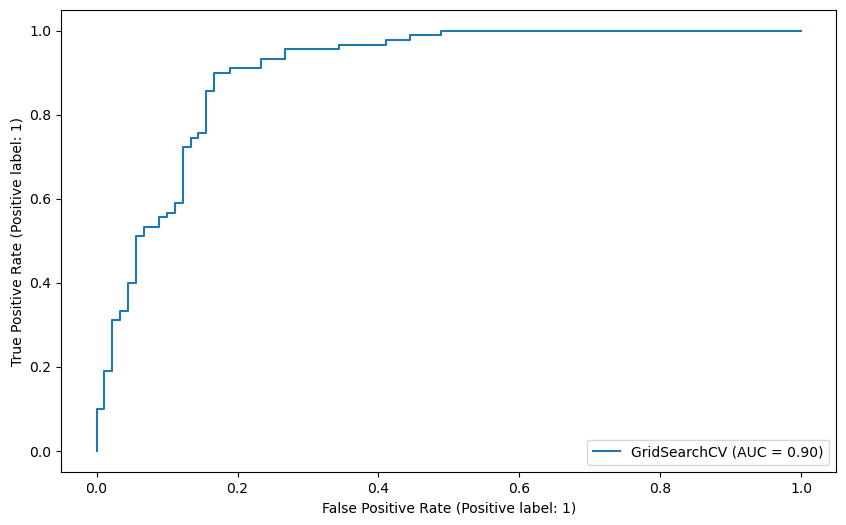

In [66]:
RocCurveDisplay.from_estimator(grid_model, X_test_scaled, y_test);

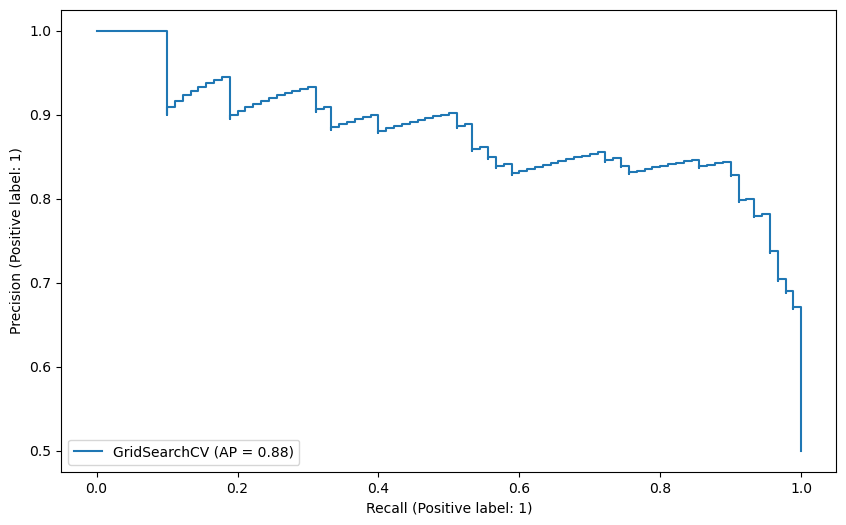

In [67]:
PrecisionRecallDisplay.from_estimator(grid_model, X_test_scaled, y_test);

# <font color='Orchid'> <b>Final Model</b><font color='black'>

In [68]:
scaler = StandardScaler().fit(X)

In [69]:
import pickle

pickle.dump(scaler, open('scaler_raisin', 'wb'))

In [70]:
X_scaled = scaler.transform(X)

In [71]:
final_model = LogisticRegression(C= 0.1, class_weight='balanced', 
                                         penalty= 'l1',
                                         solver='liblinear').fit(X_scaled, y)

In [72]:
# modeli kaydedelim

pickle.dump(final_model, open('final_model_raisin', 'wb'))